<a href="https://colab.research.google.com/github/Priyanshiiitb/Understanding_kmeans/blob/main/Kmeans_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [67]:
# prompt: install kaleido

!pip install -U kaleido


In [68]:



import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
import plotly.graph_objects as go
import matplotlib.pyplot as plt


(354, 630, 3)


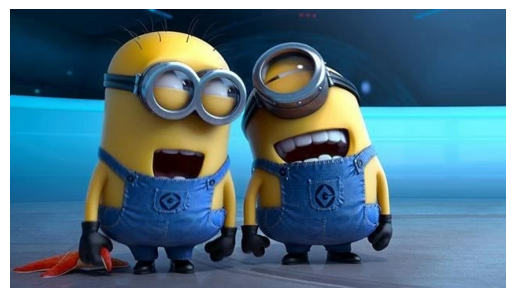

In [69]:
import matplotlib.image as mpimg
from matplotlib.pyplot import imshow
%matplotlib inline
image = mpimg.imread('/content/minion.jpg')
print(image.shape)
plt.imshow(image)
plt.axis('off');

In [70]:
# Reshape the image so that each row represents a single pixel
# defined by three values: R, G, B
image_fla = image.reshape(image.shape[0]*image.shape[1], 3)
image_fla[:5, :]

array([[0.01960784, 0.09411765, 0.1764706 ],
       [0.01960784, 0.09411765, 0.1764706 ],
       [0.01960784, 0.09411765, 0.1764706 ],
       [0.01960784, 0.09411765, 0.1764706 ],
       [0.01568628, 0.09019608, 0.17254902]], dtype=float32)

In [71]:
def unscale_array(scaled_array, scale_factor=1):
  unscaled_array = scaled_array * 255* scale_factor
  return unscaled_array


In [72]:
image_flat=unscale_array(image_fla,1)

In [73]:
image_flat[:5, :]

array([[ 5., 24., 45.],
       [ 5., 24., 45.],
       [ 5., 24., 45.],
       [ 5., 24., 45.],
       [ 4., 23., 44.]], dtype=float32)

In [74]:
# prompt: make above value to integer

image_flat = image_flat.astype(int)


In [75]:
image_flat[:5, :]

array([[ 5, 24, 45],
       [ 5, 24, 45],
       [ 5, 24, 45],
       [ 5, 24, 45],
       [ 4, 23, 44]])

In [76]:
image_flat.shape

(223020, 3)

In [77]:

# Convert the flattened image array into a DataFrame
df = pd.DataFrame(image_flat, columns=['r', 'g', 'b'])

# Display the first five rows of the DataFrame
df.head()


,r,g,b
0,5,24,45
1,5,24,45
2,5,24,45
3,5,24,45
4,4,23,44


In [78]:
# prompt: noe create  3D plot of the pixel where each value shows its own colour

# Create a 3D plot with colors based on RGB values
fig = go.Figure(data=[go.Scatter3d(
    x=df['r'],
    y=df['g'],
    z=df['b'],
    mode='markers',
    marker=dict(
        size=1,
        color=df['r'] + df['g'] + df['b'],
        opacity=0.8
    )
)])

# Set the axes labels
fig.update_layout(scene=dict(
    xaxis=dict(title='Red'),
    yaxis=dict(title='Green'),
    zaxis=dict(title='Blue')
))

# Show the plot
fig.show()


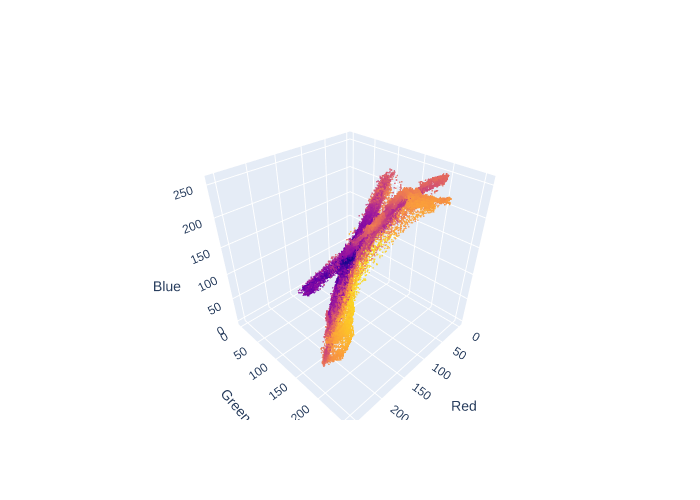

In [79]:
# prompt: i want  just an image for above 3d plot use ipython display

from IPython.display import Image
img_bytes = fig.to_image(format="png")
Image(img_bytes)


In [80]:
# Instantiate the model
kmeans = KMeans(n_clusters=1, random_state=42).fit(image_flat)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



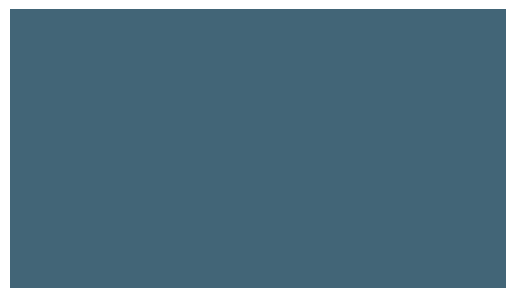

In [81]:
# Copy `img_flat` so we can modify it
image_flat1 = image_flat.copy()

# Replace each row in the original image with its closest cluster center
for i in np.unique(kmeans.labels_):
    image_flat1[kmeans.labels_==i,:] = kmeans.cluster_centers_[i]

# Reshape the data back to (640, 480, 3)
img1 = image_flat1.reshape(image.shape)

plt.imshow(img1)
plt.axis('off');

In [82]:
# Calculate mean of each column in the flattened array
column_means = image_flat.mean(axis=0)

print('column means: ', column_means)

column means:  [ 66.69095148 101.51054166 119.61817326]


In [83]:
print('cluster centers: ', kmeans.cluster_centers_)

cluster centers:  [[ 66.69095148 101.51054166 119.61817326]]


In [84]:
# prompt: again create  3D plot of the pixel where each value shows its own colour and add the centroid we find inthe notebook

fig = go.Figure(data=[go.Scatter3d(
    x=df['r'],
    y=df['g'],
    z=df['b'],
    mode='markers',
    marker=dict(
        size=1,
        color=df['r'] + df['g'] + df['b'],
        opacity=0.8
    )
)])

# Add the centroid to the plot
fig.add_trace(go.Scatter3d(
    x=[kmeans.cluster_centers_[0][0]],
    y=[kmeans.cluster_centers_[0][1]],
    z=[kmeans.cluster_centers_[0][2]],
    mode='markers',
    marker=dict(
        size=10,
        color='red',
        opacity=1
    )
))

# Set the axes labels
fig.update_layout(scene=dict(
    xaxis=dict(title='Red'),
    yaxis=dict(title='Green'),
    zaxis=dict(title='Blue')
))

# Show the plot
fig.show()


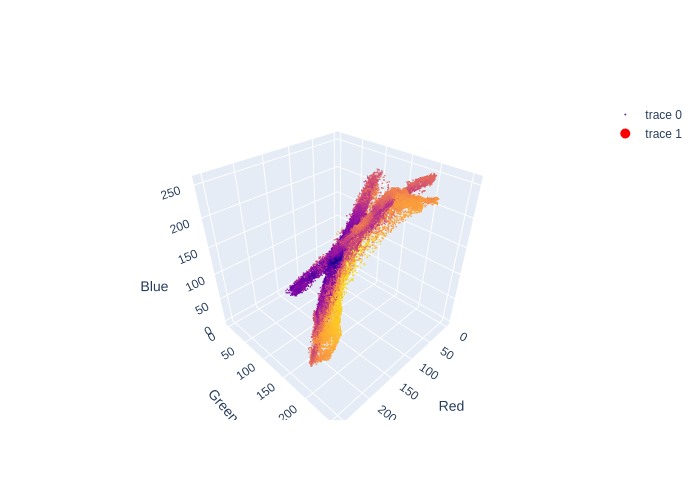

In [85]:
# prompt: i want  just an image for above 3d plot use ipython display

img_bytes = fig.to_image(format="png")
Image(img_bytes)


In [86]:
# Instantiate k-means model for 3 clusters
kmeans3 = KMeans(n_clusters=3, random_state=42).fit(image_flat)

# Check the unique values of what's returned by the .labels_ attribute
np.unique(kmeans3.labels_)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



array([0, 1, 2], dtype=int32)

In [87]:
# Assign centroid coordinates to `centers` variable
centers = kmeans3.cluster_centers_
centers

array([[ 77.70465021,  99.36676512, 112.82165322],
       [ 19.7242057 ,  37.29747445,  57.86541826],
       [111.18625544, 184.36096481, 205.35432187]])

In [88]:
# Helper function that creates color swatches
def show_swatch(RGB_value):
    '''
    Takes in an RGB value and outputs a color swatch
    '''
    R, G, B = RGB_value
    rgb = [[np.array([R,G,B]).astype('uint8')]]
    plt.figure()
    plt.imshow(rgb)
    plt.axis('off');

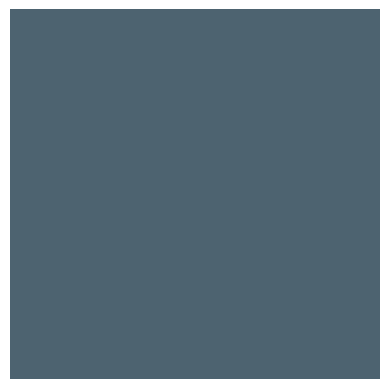

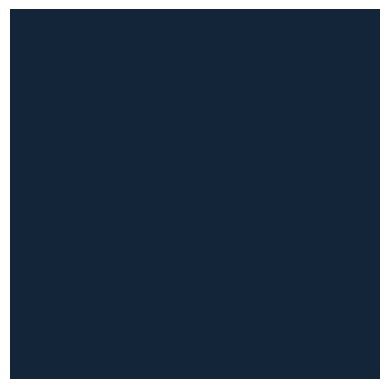

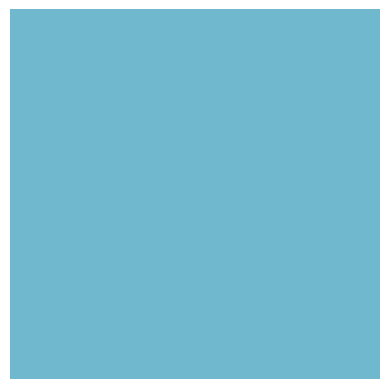

In [89]:
# Display the color swatches
for pixel in centers:
    show_swatch(pixel)

In [90]:
# Helper function to display our photograph when clustered into k clusters
def cluster_image(k, img=image):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image.

    Args:
      k:    (int)          - Your selected K-value
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      The output of plt.imshow(new_img), where new_img is a new numpy array \
      where each row of the original array has been replaced with the \
      coordinates of its nearest centroid.
    '''

    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters = k, random_state = 42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_ == i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)

    return plt.imshow(new_img), plt.axis('off');


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



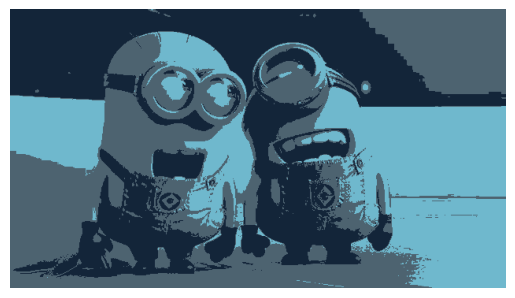

In [91]:
# Generate image when k=3
cluster_image(3);

In [92]:
# Just to get an understanding of what the data structures look like

print(kmeans3.labels_.shape)
print(kmeans3.labels_)
print(np.unique(kmeans3.labels_))
print(kmeans3.cluster_centers_)


df.head()

(223020,)
[1 1 1 ... 2 2 2]
[0 1 2]
[[ 77.70465021  99.36676512 112.82165322]
 [ 19.7242057   37.29747445  57.86541826]
 [111.18625544 184.36096481 205.35432187]]


,r,g,b
0,5,24,45
1,5,24,45
2,5,24,45
3,5,24,45
4,4,23,44


In [93]:
# Create a new column in the df that indicates the cluster number of each row
# (as assigned by Kmeans for k=3)
df['cluster'] = kmeans3.labels_
df.head()

,r,g,b,cluster
0,5,24,45,1
1,5,24,45,1
2,5,24,45,1
3,5,24,45,1
4,4,23,44,1


In [94]:
# Create helper dictionary to map RGB color values to each observation in df
series_conversion = {0: 'rgb' +str(tuple(kmeans3.cluster_centers_[0])),
                     1: 'rgb' +str(tuple(kmeans3.cluster_centers_[1])),
                     2: 'rgb' +str(tuple(kmeans3.cluster_centers_[2])),
                     }
series_conversion

{0: 'rgb(77.7046502144252, 99.36676511659813, 112.8216532173184)',
 1: 'rgb(19.72420569509739, 37.297474452937095, 57.8654182620587)',
 2: 'rgb(111.1862554368731, 184.36096480829906, 205.35432186628708)'}

In [95]:
# Replace the cluster numbers in the 'cluster' col with formatted RGB values
# (made ready for plotting)
df['cluster'] = df['cluster'].map(series_conversion)
df.head()

,r,g,b,cluster
0,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
1,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
2,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
3,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
4,4,23,44,"rgb(19.72420569509739, 37.297474452937095, 57...."


In [96]:
df.head(10)

,r,g,b,cluster
0,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
1,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
2,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
3,5,24,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
4,4,23,44,"rgb(19.72420569509739, 37.297474452937095, 57...."
5,4,23,44,"rgb(19.72420569509739, 37.297474452937095, 57...."
6,4,23,44,"rgb(19.72420569509739, 37.297474452937095, 57...."
7,4,23,44,"rgb(19.72420569509739, 37.297474452937095, 57...."
8,3,25,45,"rgb(19.72420569509739, 37.297474452937095, 57...."
9,2,26,45,"rgb(19.72420569509739, 37.297474452937095, 57...."


In [97]:
# Replot the data, now showing which cluster (i.e., color) it was assigned to by K-means when k=3

trace = go.Scatter3d(x = df.r,
                     y = df.g,
                     z = df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=df.cluster,
                                 opacity=1))

data = trace

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0))

fig = go.Figure(data=data, layout=layout)
fig.show()

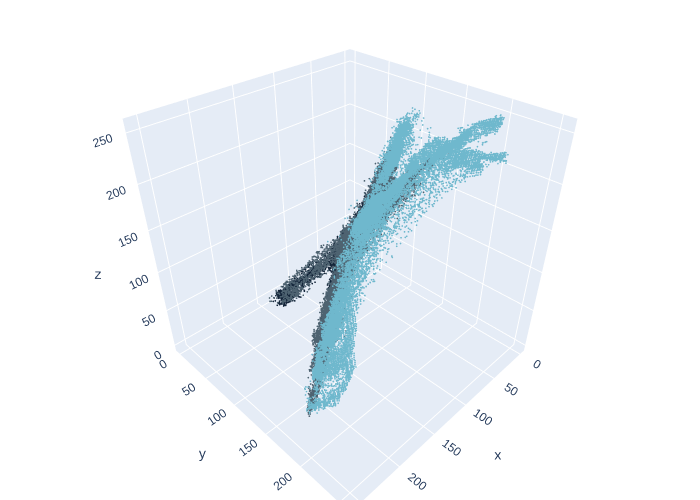

In [98]:
# prompt: i want  just an image for above 3d plot use ipython display

img_bytes = fig.to_image(format="png")
Image(img_bytes)


In [99]:
import matplotlib.pyplot as plt
%pylab inline

Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.10/dist-packages/IPython/core/magics/pylab.py:159: UserWarning:

pylab import has clobbered these variables: ['trace']
`%matplotlib` prevents importing * from pylab and numpy



/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will 

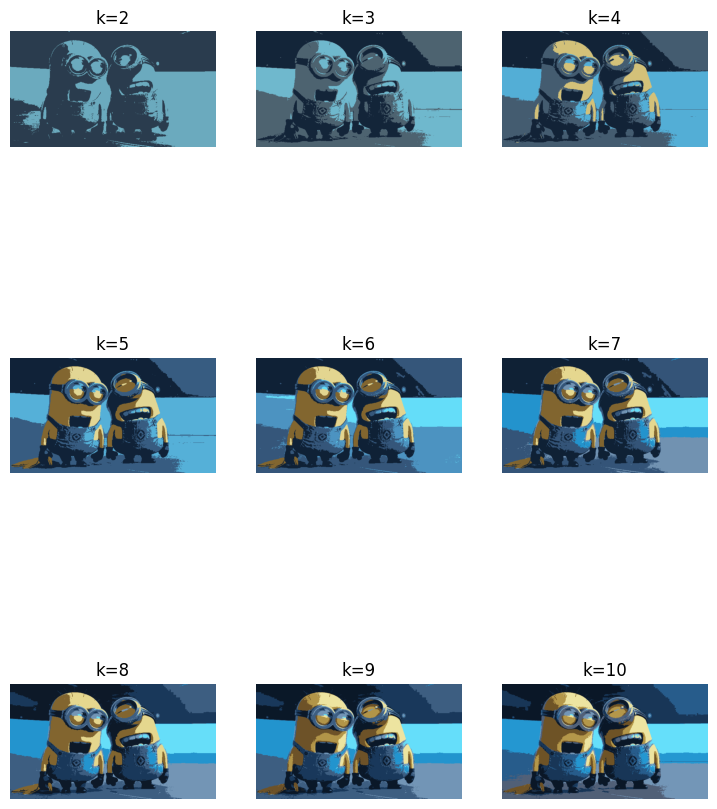

In [100]:
# Helper function to plot image grid
def cluster_image_grid(k, ax, img=image):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig = plt.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=image)
    axs[i].title.set_text('k=' + str(k))

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will 

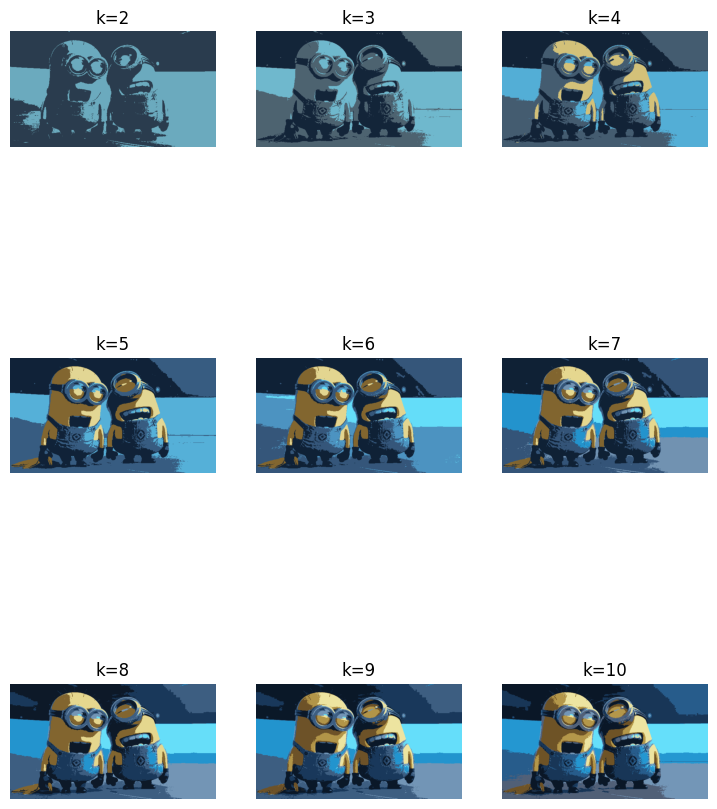

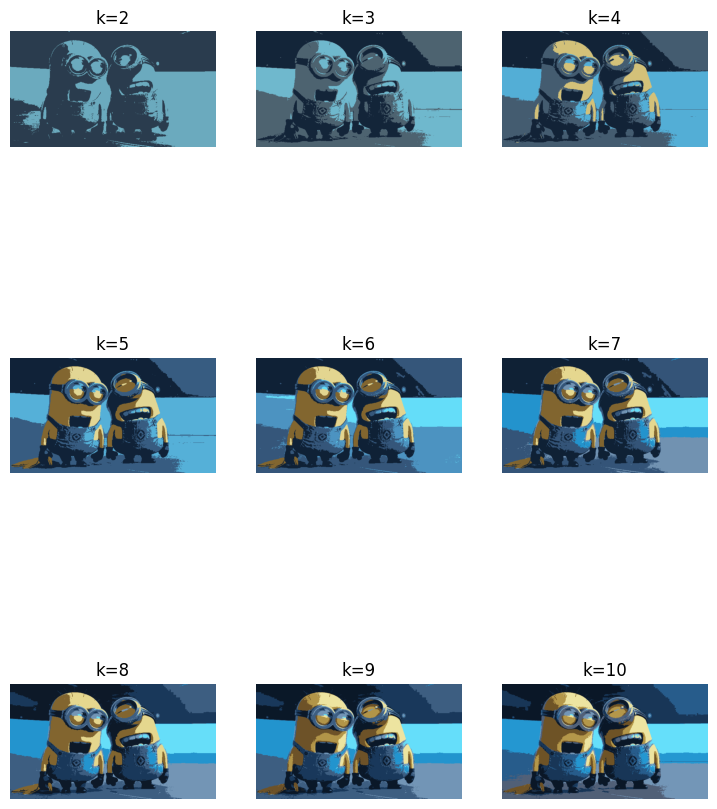

In [101]:
# prompt: i want  just an image for above plot

import matplotlib.pyplot as plt
import numpy as np
import kaleido

fig, axs = plt.subplots(3, 3)
fig = plt.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=image)
    axs[i].title.set_text('k=' + str(k))

# Save the plot as an image
fig.savefig("cluster_image_grid.png", bbox_inches='tight')

# Display the image
Image("cluster_image_grid.png")
